# Treating MRI contrasts

This notebook corresponds to the section titled **"Preparation of fMRI Data"** and utilizes the `fmri_data_preparation` function from the `MEEG_fMRI_whole_compa_script.py` script. It also uses the function `t_bids_formalism_conversion`, which is also employed in `convert_fMRI2BIDS()`, to ensure that t-statistics are saved in BIDS format.

In this notebook, fMRI contrasts are processed through thresholding, correction, and conversion to z-scores. Additionally, brain masks are created to support subsequent analyses.

## Import the necessary libraries 

In [1]:
import numpy as np
import pandas as pd
import nibabel as nib
from pathlib import Path
from scipy.stats import norm
import warnings
import time
import sys
import matplotlib.pyplot as plt
import logging

from nilearn.glm import threshold_stats_img
from nilearn.plotting import plot_stat_map
from nilearn.image import resample_img
from nilearn.maskers import NiftiMasker

# Personal Imports
# Add the directory that contains the utils package to sys.path
sys.path.append(str(Path('..').resolve()))

from utils.nifti_utils import extract_dof_from_niftiheader, extract_threshold
from utils.contrast_utils import p_value_to_zscore, process_t2zscore
from utils.utils import setup_logging, trackprogress
from utils.mask_utils import process_ribbon
from utils.threshold_utils import resample_and_threshold_image

## Path to the dataset

Before running the notebooks, make sure to update the paths in `config.py` to match your local setup.

- **`path_to_mri_data`**: Specify the directory where the MRI data output by SPM is saved.
- **`local_dir`**: Set this to the directory where the BIDS-formatted data will be stored.
- **`data_info_dir`**: Provide the path to the directory containing the Excel files named `SPM_con_x.xlsx`. These files are crucial for mapping SPM contrast numbers (e.g., `spmT_0001`) to their corresponding contrast names (e.g., task: aud, contrast: sine). Each task has its own Excel file. You can download these files from the GitHub repository: [Internship_MEEG_IRM](https://github.com/liliaponselle/Internship_MEEG_IRM.git) in the `data_info` directory.

In [2]:
from config import PATH_TO_MRI_DATA, LOCAL_DIR, MRI_DATA_CONV_INFO_DIR

path_to_mri_data = PATH_TO_MRI_DATA
local_dir = LOCAL_DIR
data_info_dir =  MRI_DATA_CONV_INFO_DIR

## Get the subjects names for this study

**Subject Exclusions and Issues:**

- **Subjects 1 and 2**: Excluded from analysis because their results in the native space are not available.
- **Subject 11**: Removed due to issues encountered during data acquisitions.
- **Subject 10**: Not available.

In [3]:
# Create a list of subjects from 'sub-03' to 'sub-17'
subjects = [f"sub-{i:02}" for i in range(3, 18) if i not in [11, 10]]

# Print the updated list to verify
print(subjects)

['sub-03', 'sub-04', 'sub-05', 'sub-06', 'sub-07', 'sub-08', 'sub-09', 'sub-12', 'sub-13', 'sub-14', 'sub-15', 'sub-16', 'sub-17']


## Define the different task and contrast of interest

In this cell, additional contrasts are defined compared to the ones in the config file. This is because more contrasts are currently available for the fMRI data. However, in the `MEEG_fMRI_whole_compa_script.py`, only the contrasts specified in the config file will be thresholded when using the `fmri_data_preparation()` function.

In [4]:
# For each task associate the contrast of interest
tasks_contrasts = {
                    "aud": ['sine', 'piano1', 'piano4', 'div', 'piano1_min_sine', 'piano4_min_sine', 'piano4_min_piano1'],
                    "aud_all": ['audioStim'],
                    "feet": ['leftfoot', 'rightfoot', 'L_min_R', 'R_min_L'],
                    "fing": ['finger'],
                    "vis": ['face', 'scramble', 'face_min_scramble', 'house']
                }

## Define the Correction Parameters for thresholding

A class has been created to set different correction parameters for fMRI data based on the given task. This approach is useful because the auditory tasks requires specific parameter settings due to the challenges posed by MRI noise during acquisition. 

Adjust the parameters within the class as needed to accommodate the requirements of different tasks.

This class can also be imported from the `config.py` file.

In [5]:
## Def the Class  for MRI correction param
class CorrectionParam:
    """
    A class to encapsulate correction parameters for fMRI data analysis.
    
    Attributes:
        fMRI_ALPHA (float): The alpha level for statistical significance.
        fMRI_CORRECTION_METHOD (str): The method used for correction (e.g., 'fpr' or 'fdr').
        fMRI_CLUSTER_THRES (int): The threshold for cluster size.
        fMRI_TWOSIDED (bool): Indicates whether a two-sided test is used.
    """
    
    # Dictionary of correction settings for different tasks
    CORRECTION_SETTINGS = {
        'aud': {'fMRI_ALPHA': 0.01, 'fMRI_CORRECTION_METHOD': 'fpr', 'fMRI_CLUSTER_THRES': 10, 'fMRI_TWOSIDED': False},
        'aud_all': {'fMRI_ALPHA': 0.01, 'fMRI_CORRECTION_METHOD': 'fpr', 'fMRI_CLUSTER_THRES': 10, 'fMRI_TWOSIDED': False},
        'default': {'fMRI_ALPHA': 0.01, 'fMRI_CORRECTION_METHOD': 'fdr', 'fMRI_CLUSTER_THRES': 10, 'fMRI_TWOSIDED': False}
    }

    def __init__(self, task: str):
        """
        Initializes the CorrectionParam instance with parameters specific to the given task.
        
        Args:
            task (str): The task name to fetch the corresponding correction settings.
        
        """
        settings = self.CORRECTION_SETTINGS.get(task, self.CORRECTION_SETTINGS['default'])
        
        # Set instance attributes based on settings
        self.fMRI_ALPHA = settings['fMRI_ALPHA']
        self.fMRI_CORRECTION_METHOD = settings['fMRI_CORRECTION_METHOD']
        self.fMRI_CLUSTER_THRES = settings['fMRI_CLUSTER_THRES']
        self.fMRI_TWOSIDED = settings['fMRI_TWOSIDED']


## Post processing

This cell outlines the functionality of the `mri_data_thresholding` function from `mri_utils.py`. It corresponds to the `fmri_data_preparation()` function in the `MEEG_fMRI_whole_compa_script.py` script.

### Key Steps:
**Thresholding and Masking**:
   - After conversion, the cell proceeds with the `mri_data_thresholding` function, which processes the contrasts to obtain thresholded z-scores. This step involves applying brain masks and performing statistical thresholding to the z-score maps.

#### Main Steps for Each Subject:

1. **Load T1 Image**:
   - Load the T1-weighted anatomical image for visualization purposes.

2. **Obtain Brain Mask**:
   - Extract the brain mask from the FreeSurfer output (`ribbon.mgz`) using the `process_ribbon` function from `utils/mask_utils.py`.

##### For Each Contrast of Each Task:

1. **Load z-score Map**:
   - **If it exists**: Load the precomputed z-score map.
   - **Otherwise**:
     - Load the t-statistics contrast image.
     - Convert the t-statistics to z-scores using the `process_t2zscore` function from `utils/contrast_utils.py`.

2. **Mask and Threshold z-scores**:
   - Resample the brain mask to match the fMRI data dimensions (this is done once per subject).
   - Apply the brain mask to the z-scores.
   - Apply thresholding to the masked z-scores and save the thresholded results.

3. **Plot Results** (if `plotting=True`):
   - Visualize the thresholded z-scores to assess the results.

### Key Details:
- **Logging**: All operations and progress are logged to `logger-fmri_data_thresholding_notebook.log` for tracking and debugging purposes.
- **Conversion and Processing**: The function ensures all contrasts are correctly converted and thresholded according to BIDS standards, with careful handling of brain masking and z-score processing.

### Note:
**Conversion to BIDS Format**:
   - Before running this script, make sure to execute the `mri2bids.py` script with `RUN_FMRICONTRAST2BIDS = True` to convert the t-stats into BIDS format if not yet done.

In [6]:
# Decide if want to plot the thresholded stat maps
plotting = True

# Setup logging
logger = setup_logging(local_dir, 'logger-fmri_data_thresholding_notebook')

# If want to suppress the resample_img warnings
warnings.filterwarnings("ignore", category=UserWarning, module='nilearn')

In [7]:
# To run the cell for a specific subject, uncomment the following line and set the desired index. 
# To switch subjects, you'll need to rerun the cell that defines the `subjects` list.
# subjects = [subjects[2]]

Analyzing sub-03.
0.00 % completed


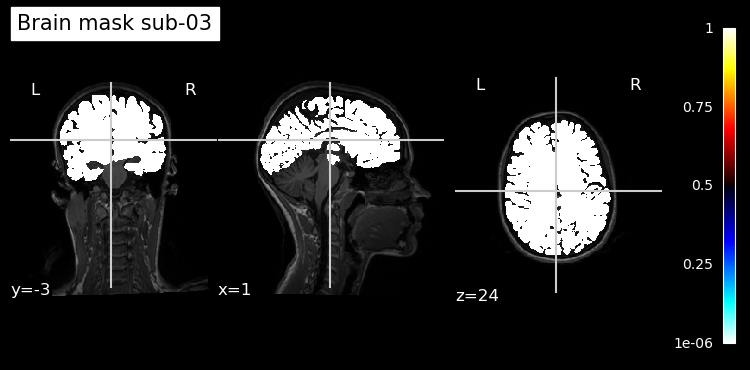

Analyzing the aud task.
Running contrast sine


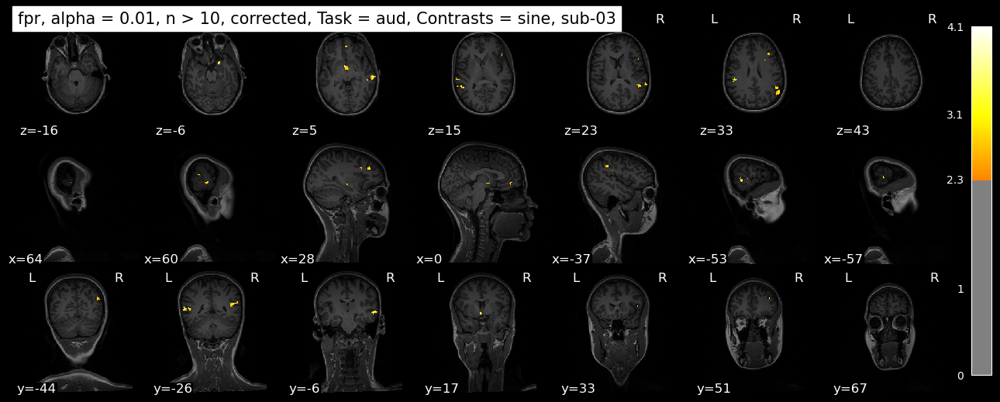

Running contrast piano1


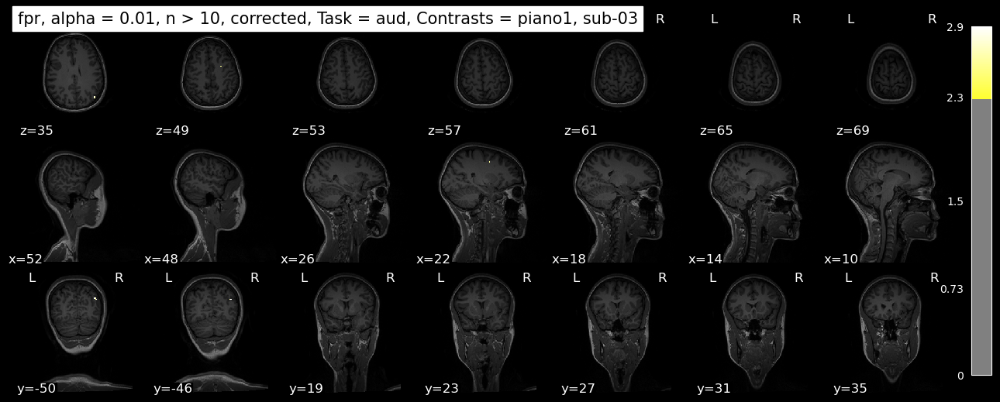

Running contrast piano4


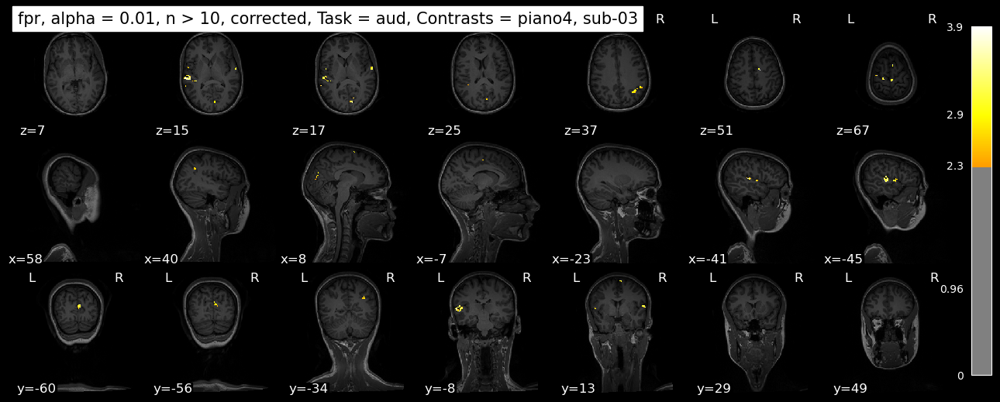

Running contrast div


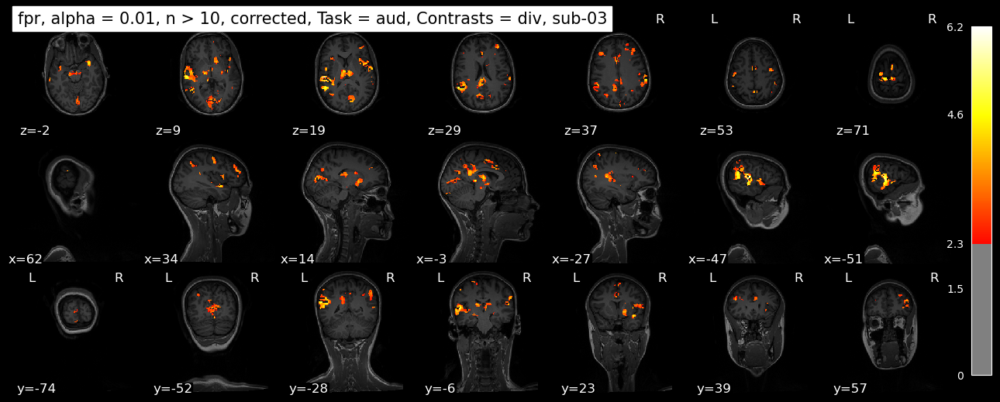

Running contrast piano1_min_sine


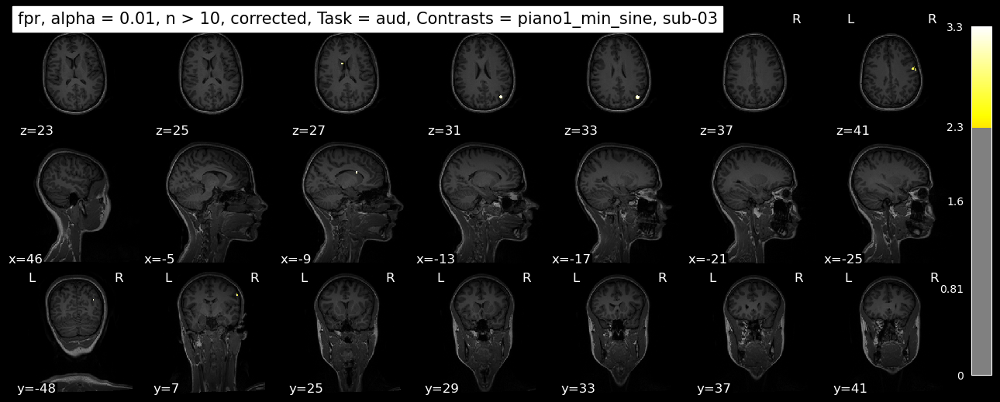

Running contrast piano4_min_sine


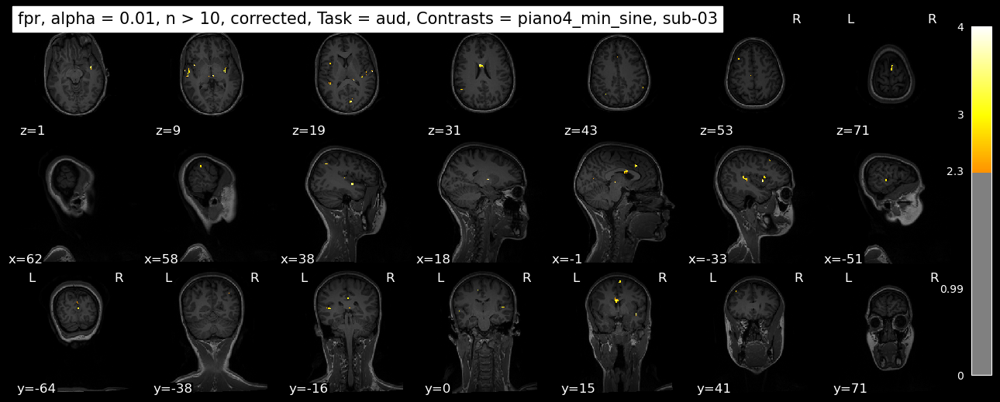

Running contrast piano4_min_piano1


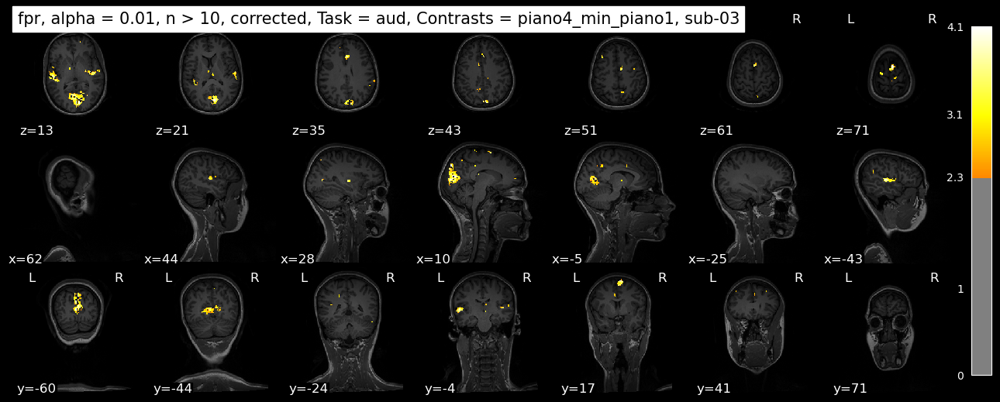

Analyzing the aud_all task.
Running contrast audioStim


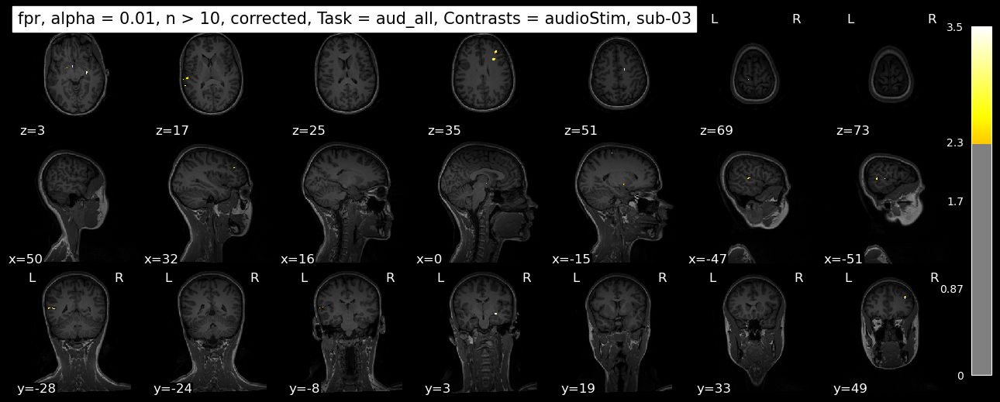

Analyzing the feet task.
Running contrast leftfoot


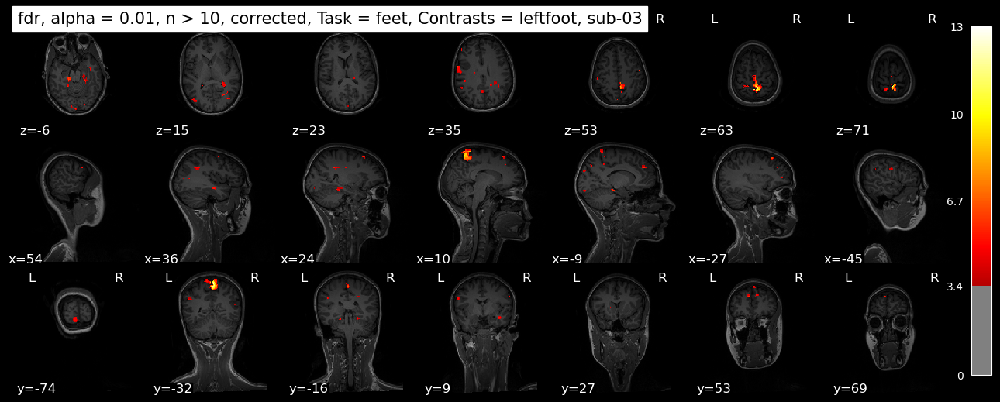

Running contrast rightfoot


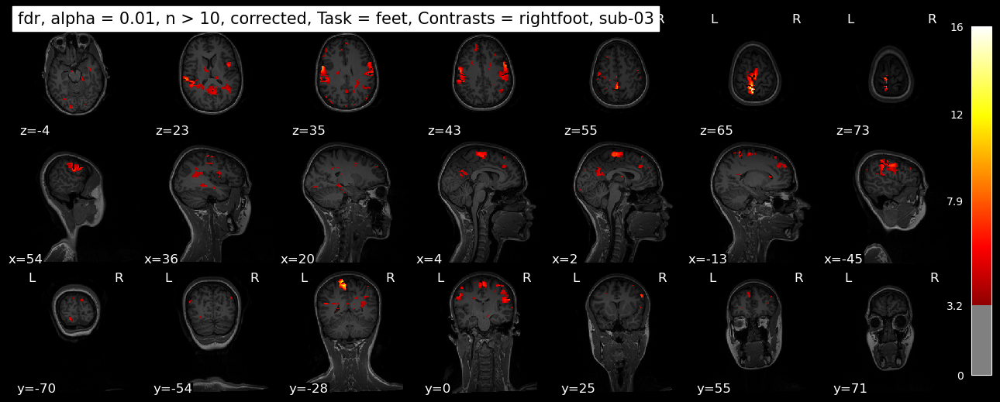

Running contrast L_min_R


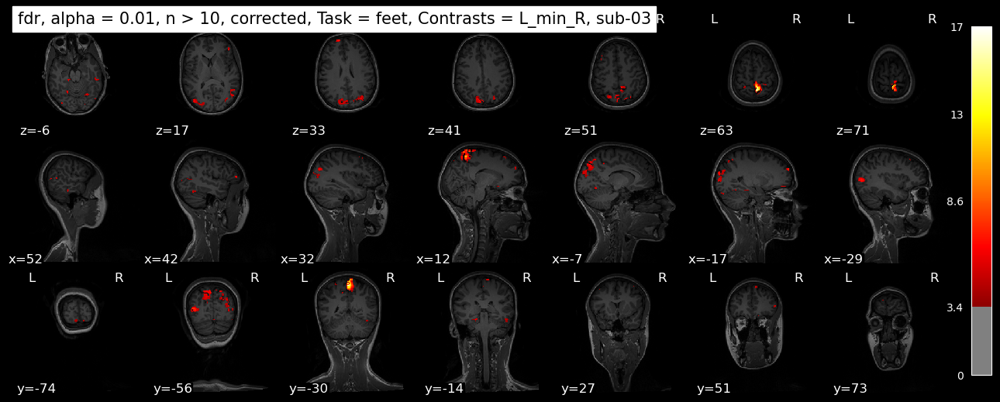

Running contrast R_min_L


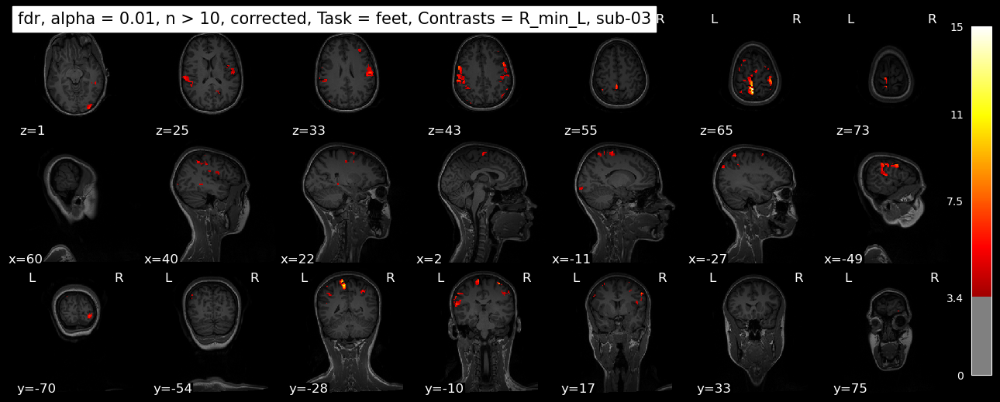

Analyzing the fing task.
Running contrast finger


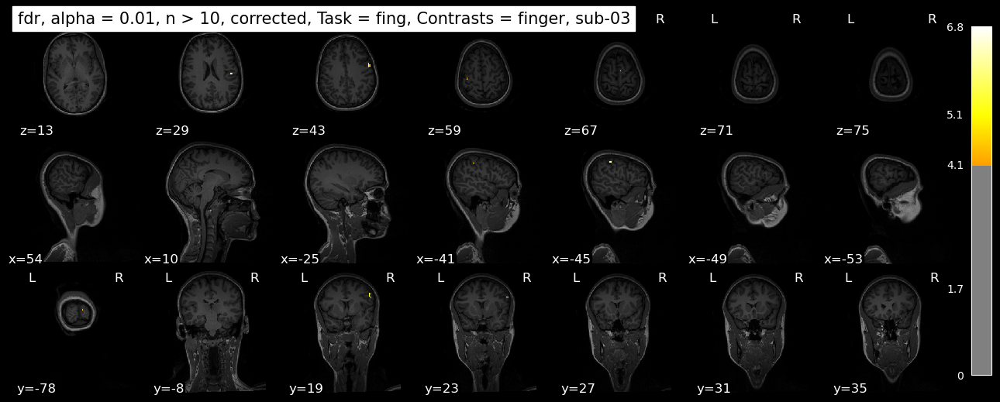

Analyzing the vis task.
Running contrast face


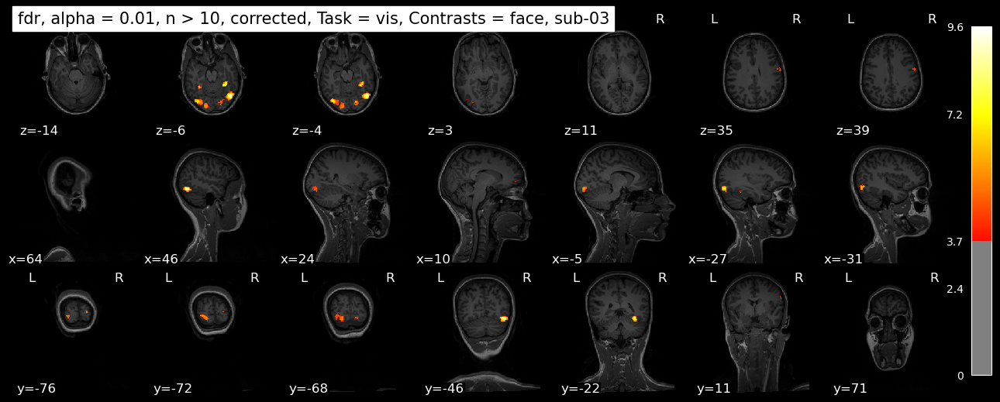

Running contrast scramble


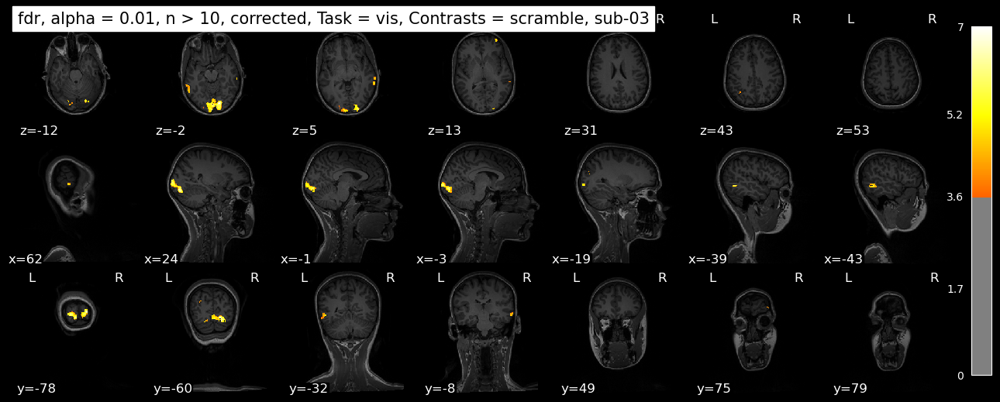

Running contrast face_min_scramble


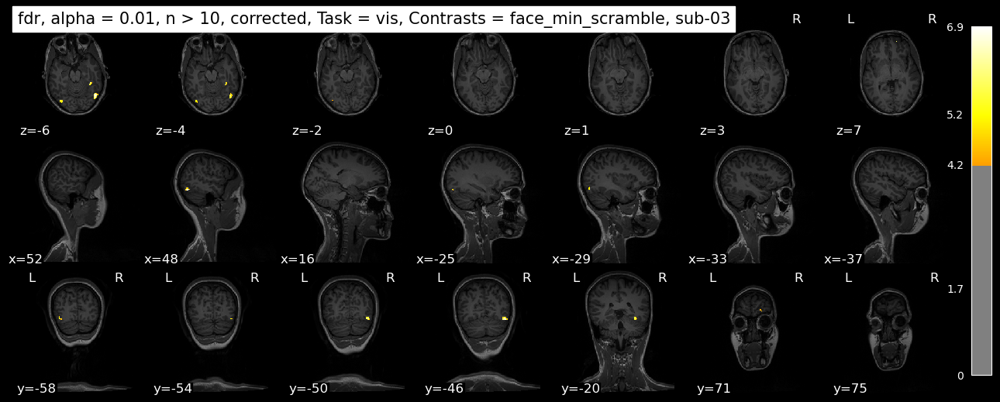

Running contrast house


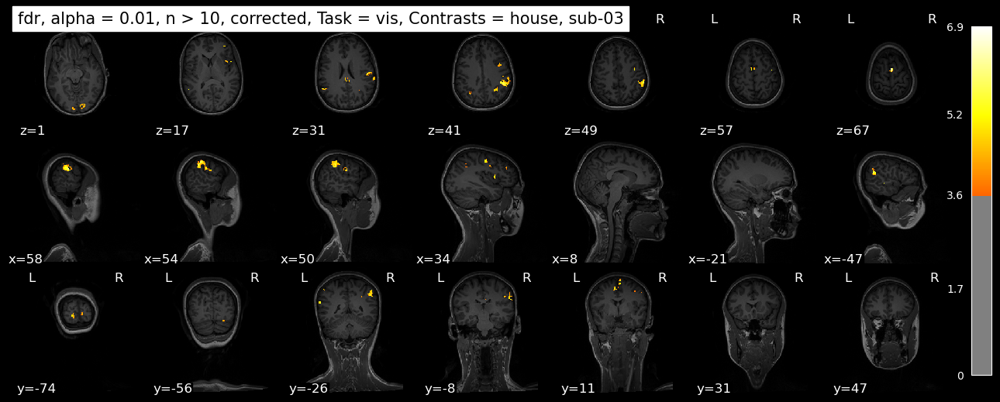

Analyzing sub-04.
7.69 % completed
Estimated remaining time: 0.0 hours, 38.0 minutes.


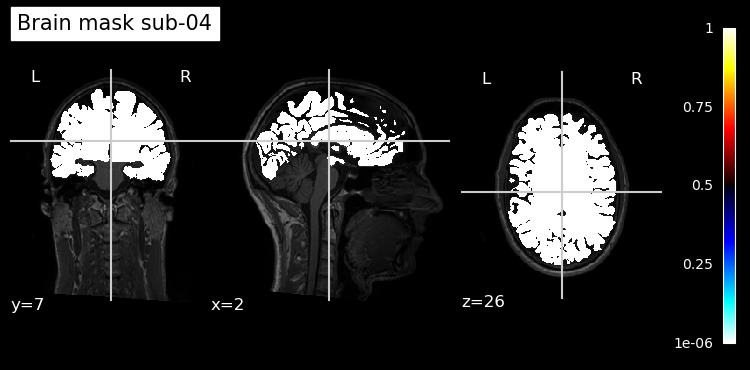

Analyzing the aud task.
Running contrast sine


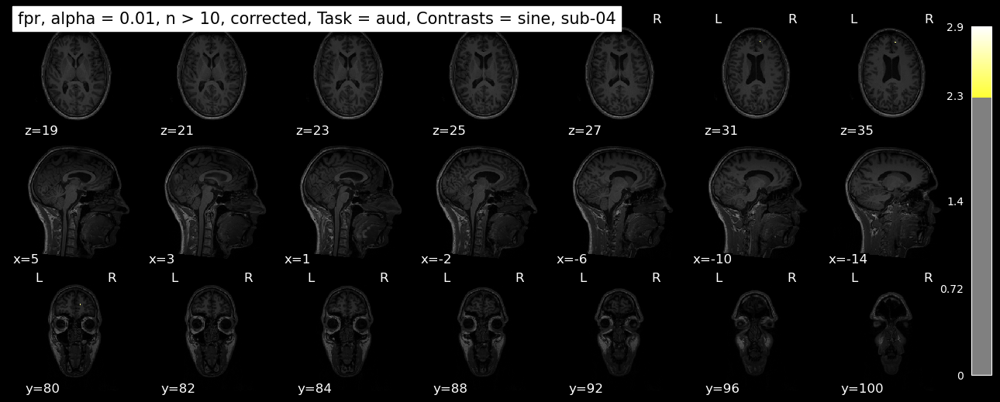

Running contrast piano1


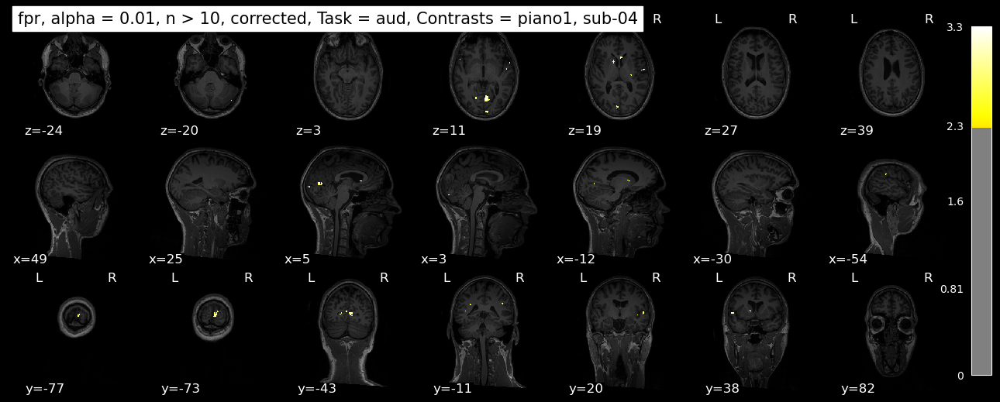

Running contrast piano4


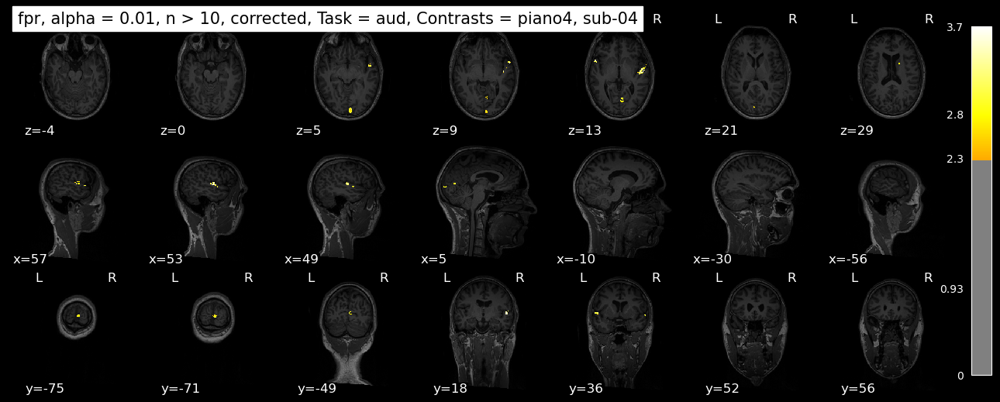

Running contrast div


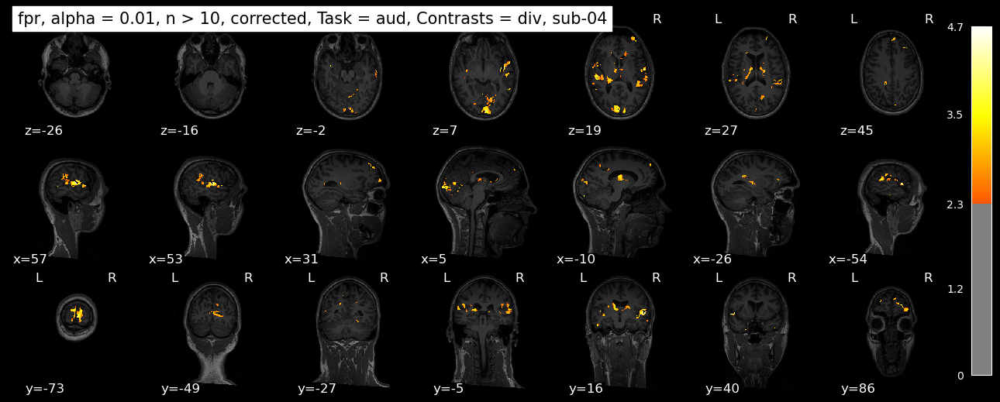

Running contrast piano1_min_sine


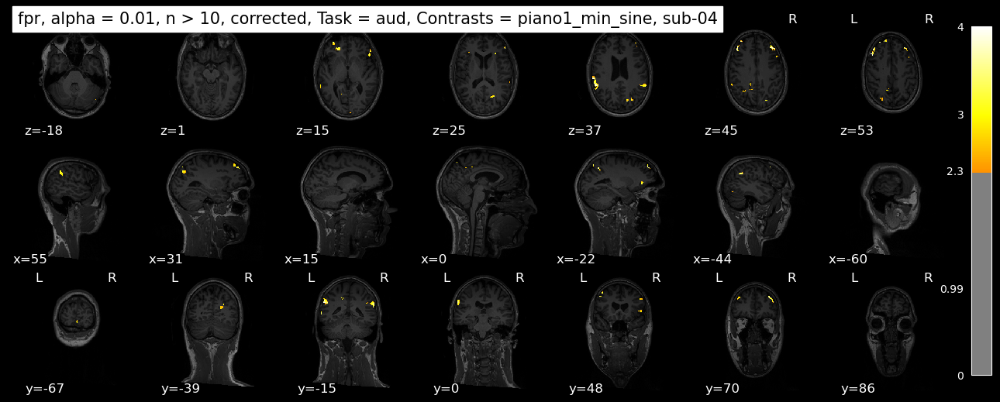

Running contrast piano4_min_sine


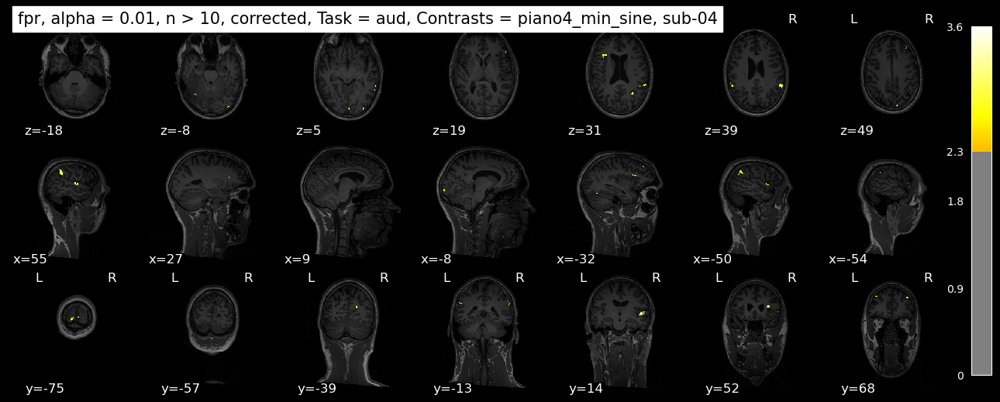

Running contrast piano4_min_piano1


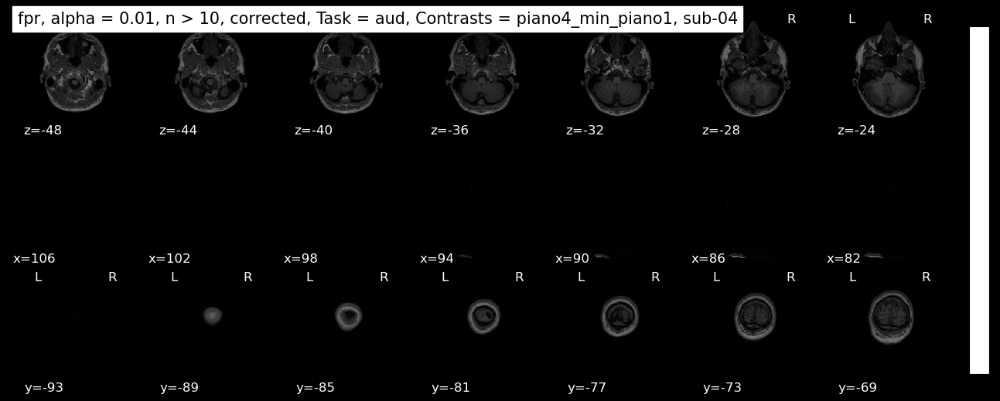

Analyzing the aud_all task.
Running contrast audioStim


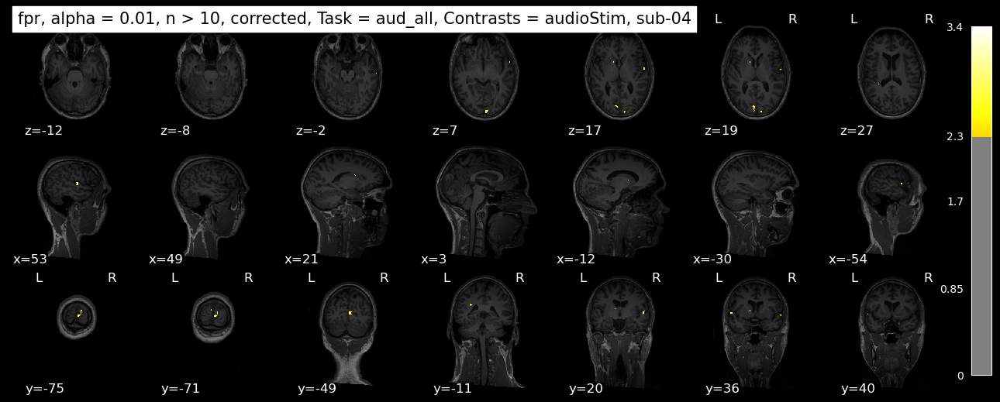

Analyzing the feet task.
Running contrast leftfoot


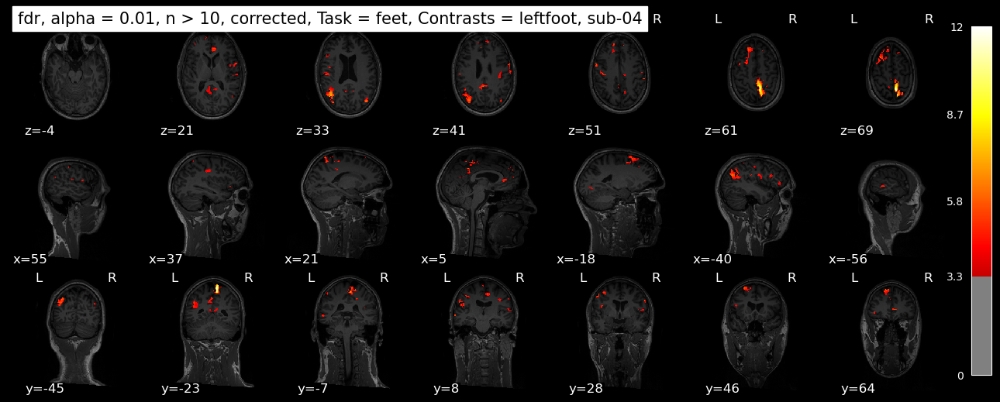

Running contrast rightfoot


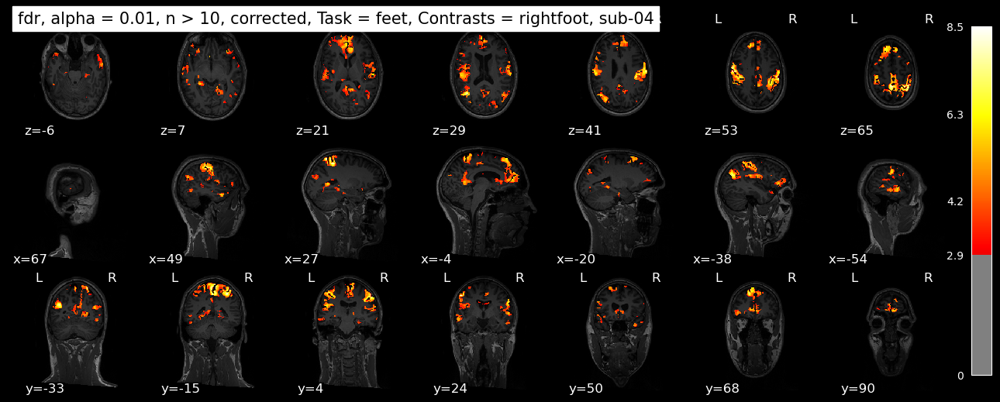

Running contrast L_min_R


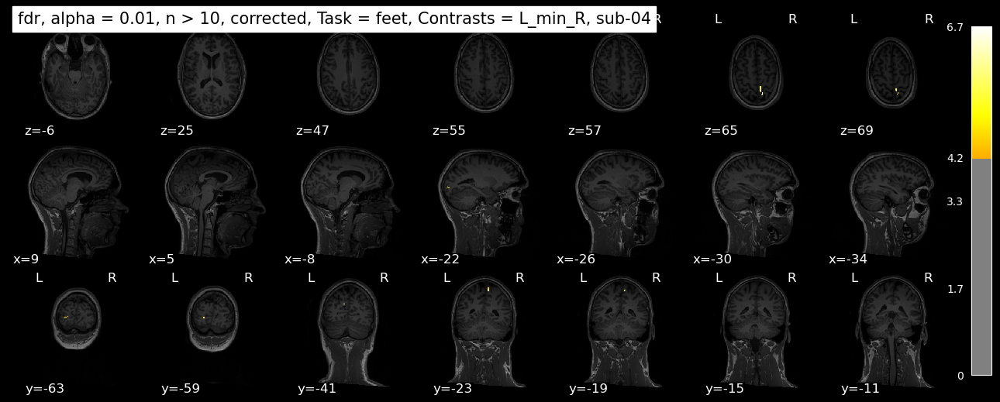

Running contrast R_min_L


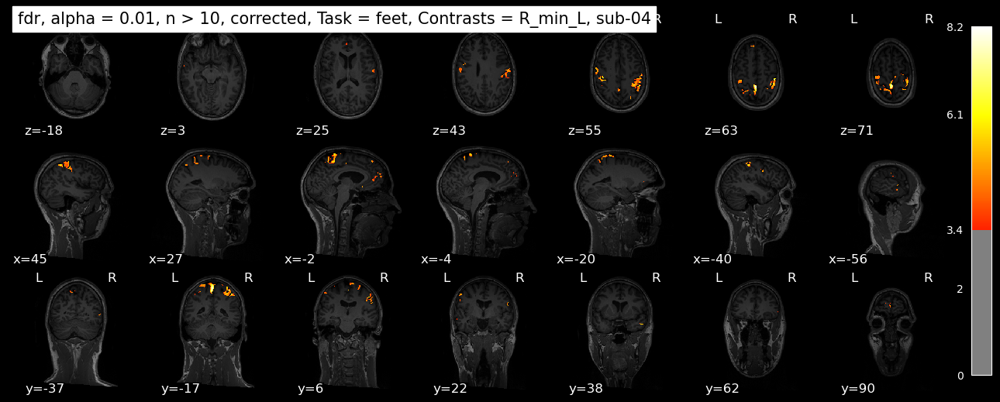

Analyzing the fing task.
Running contrast finger


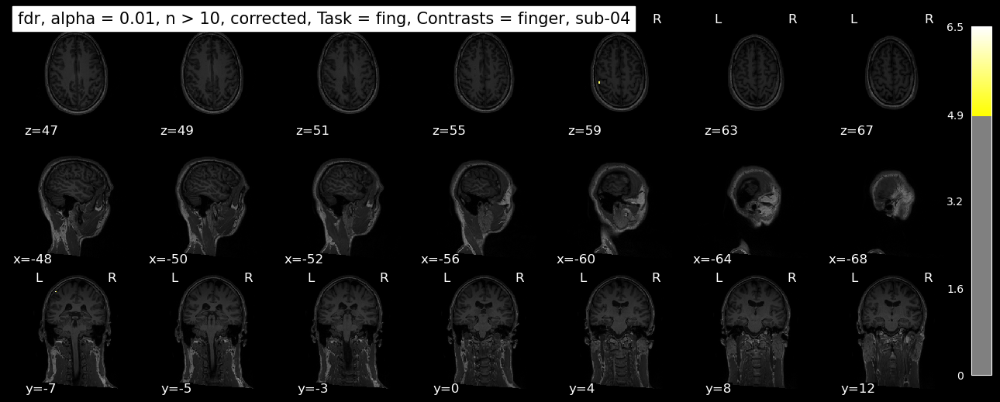

Analyzing the vis task.
Running contrast face


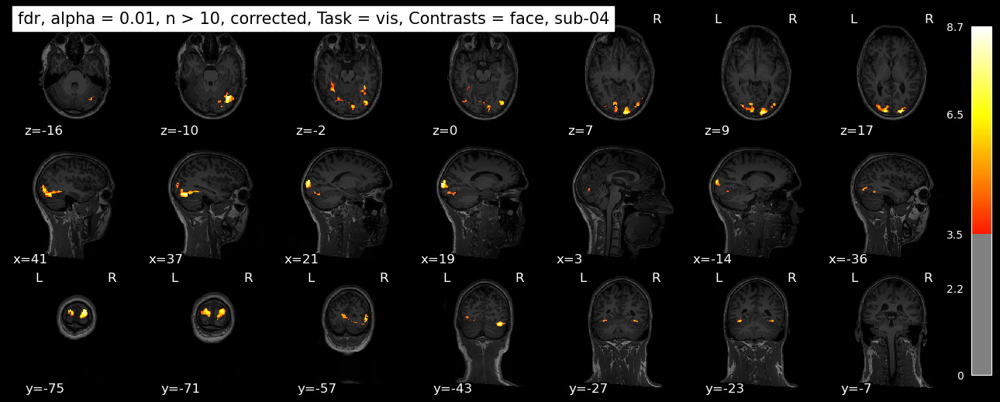

Running contrast scramble


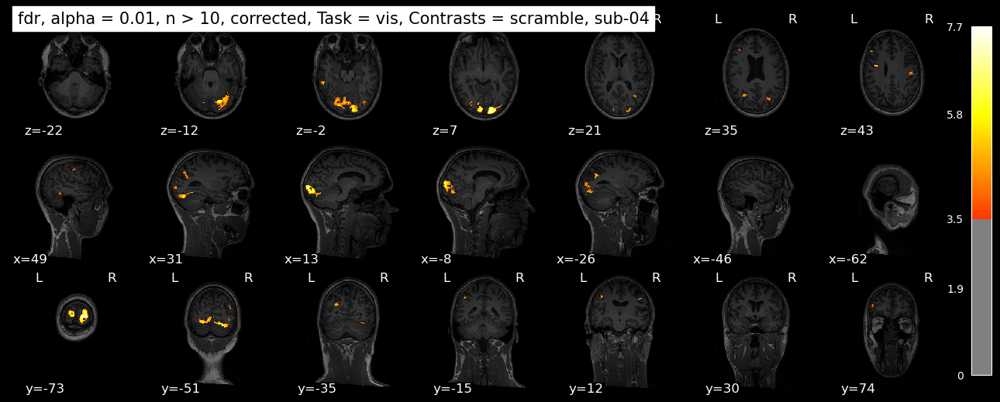

Running contrast face_min_scramble


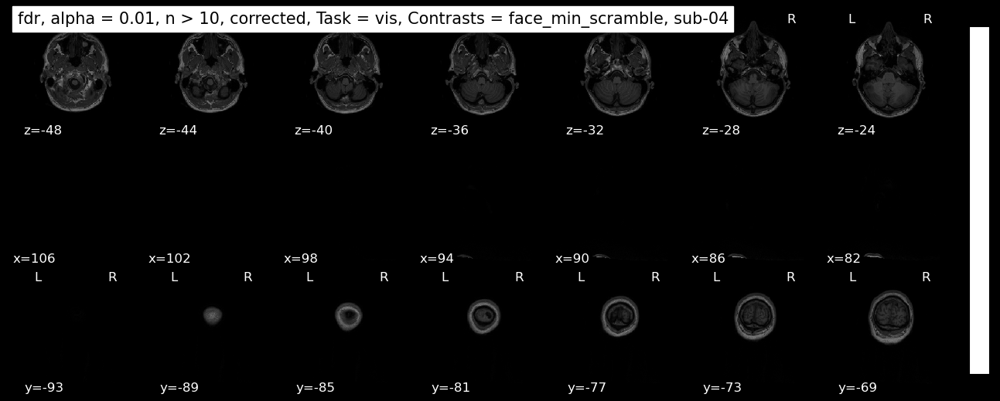

Running contrast house


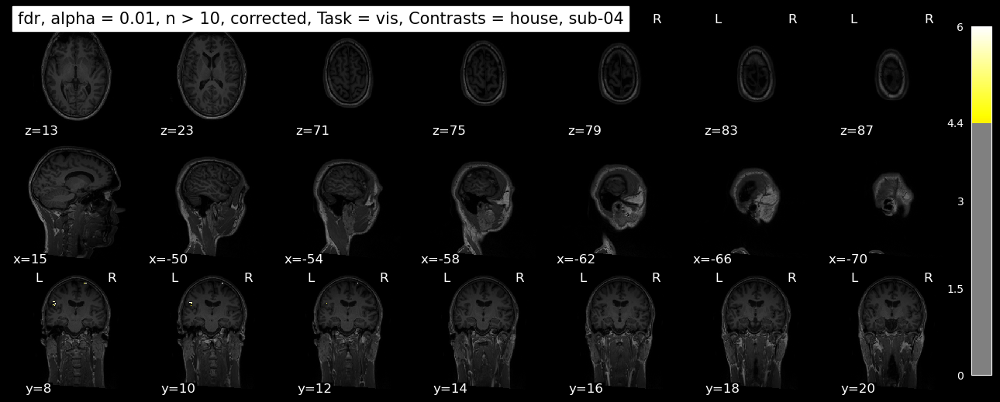

Analyzing sub-05.
15.38 % completed
Estimated remaining time: 0.0 hours, 35.0 minutes.


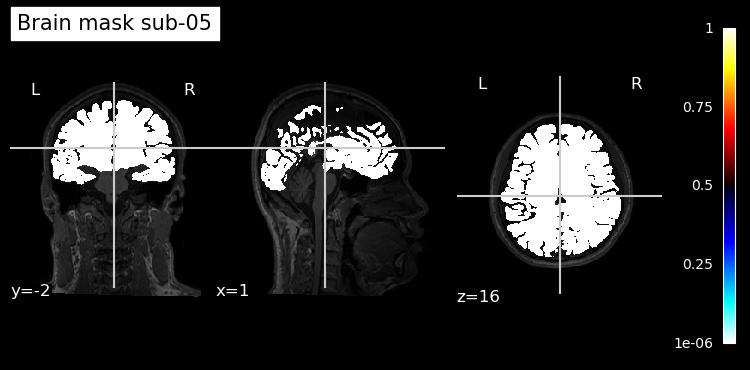

Analyzing the aud task.
Running contrast sine


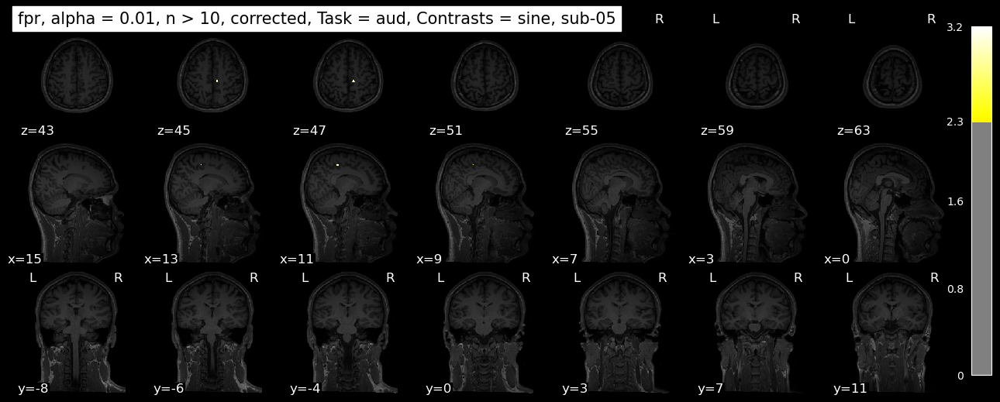

Running contrast piano1


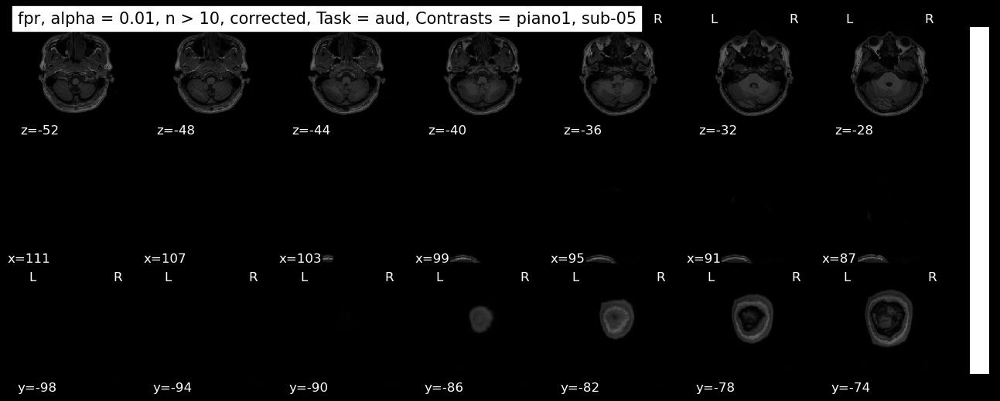

Running contrast piano4


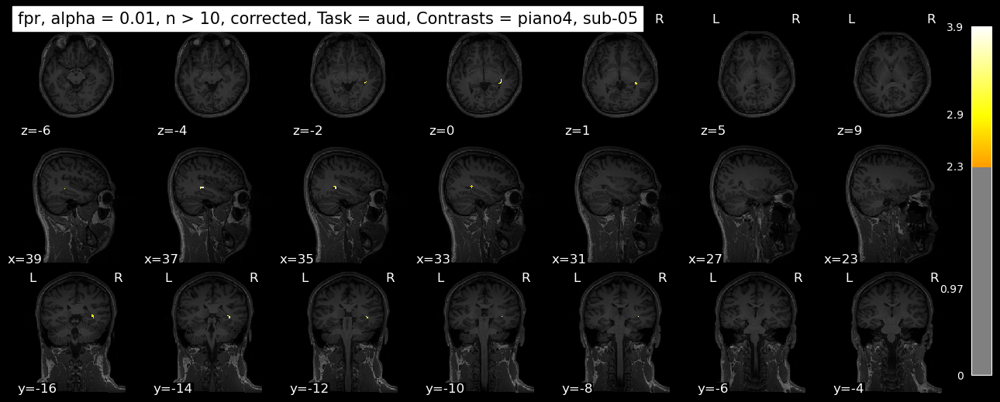

Running contrast div


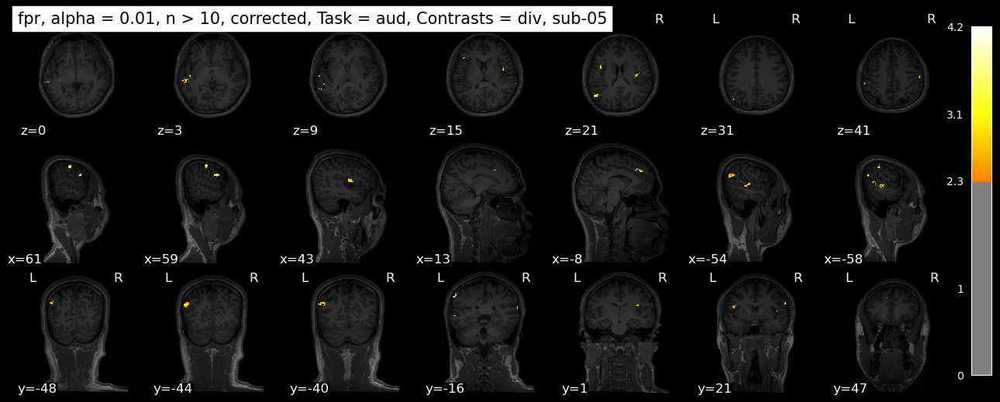

Running contrast piano1_min_sine


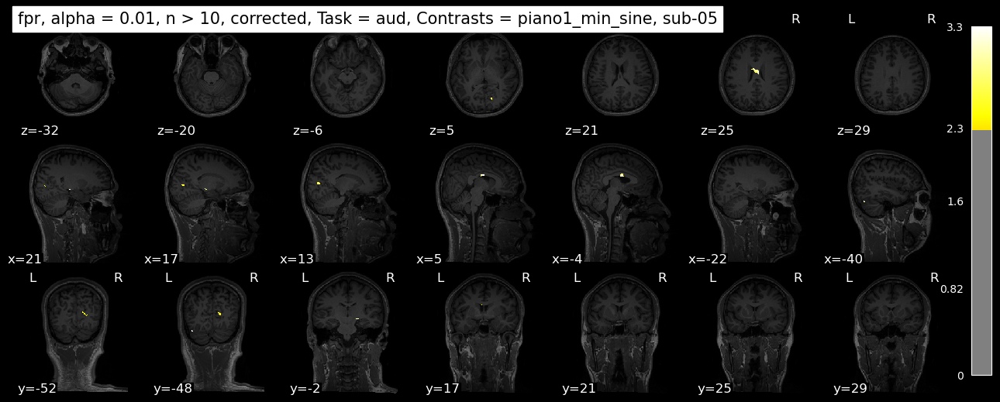

Running contrast piano4_min_sine


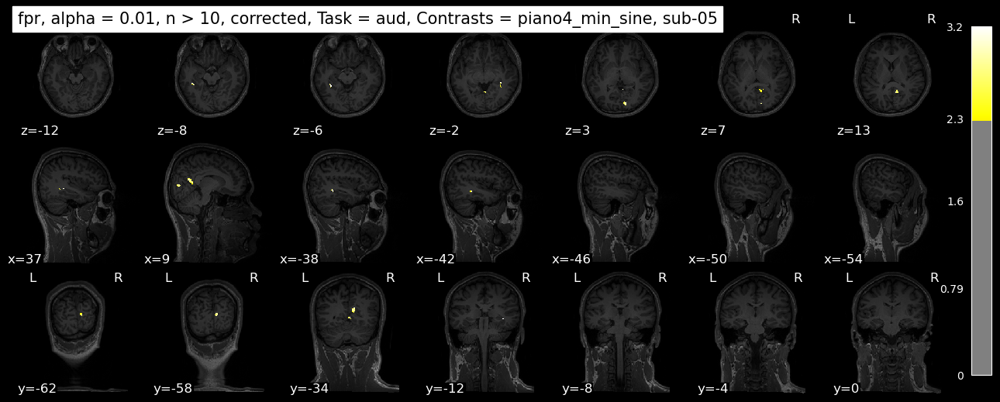

Running contrast piano4_min_piano1


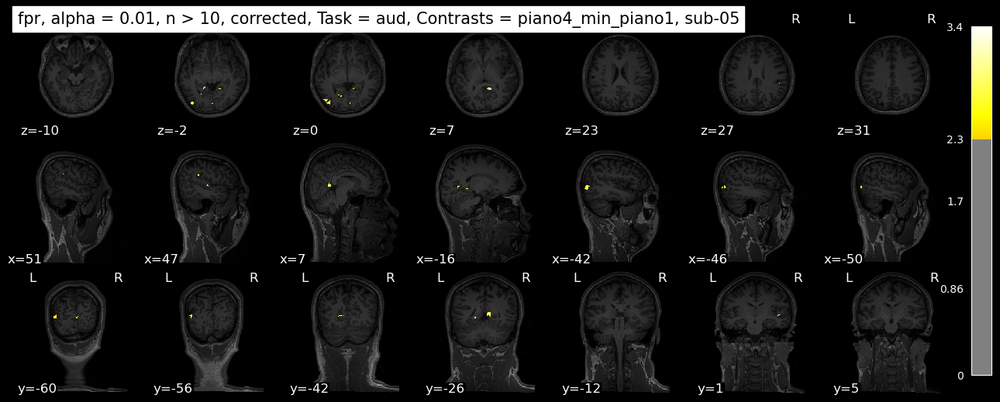

Analyzing the aud_all task.
Running contrast audioStim


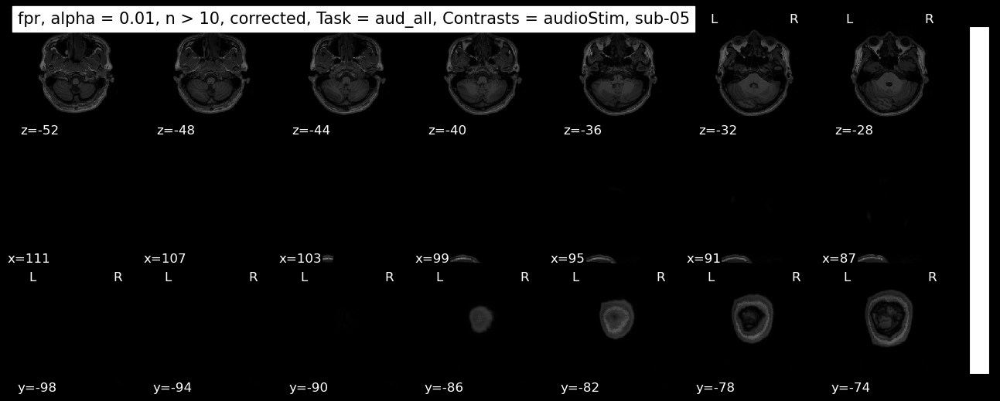

Analyzing the feet task.
Running contrast leftfoot


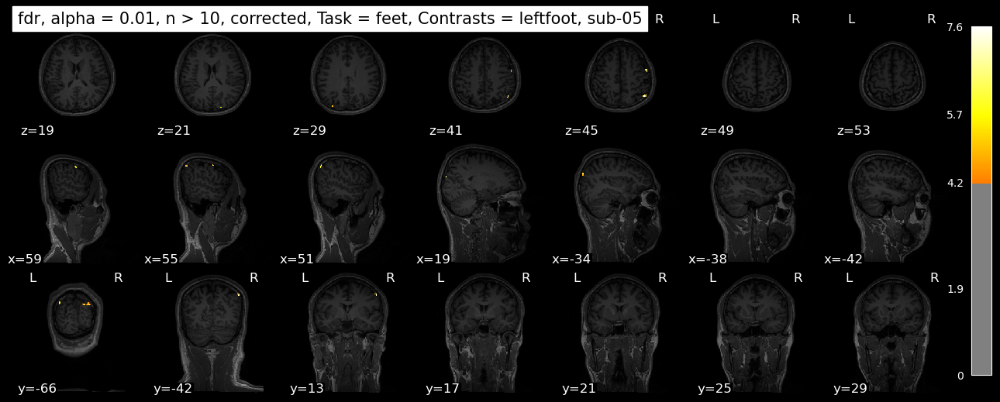

Running contrast rightfoot


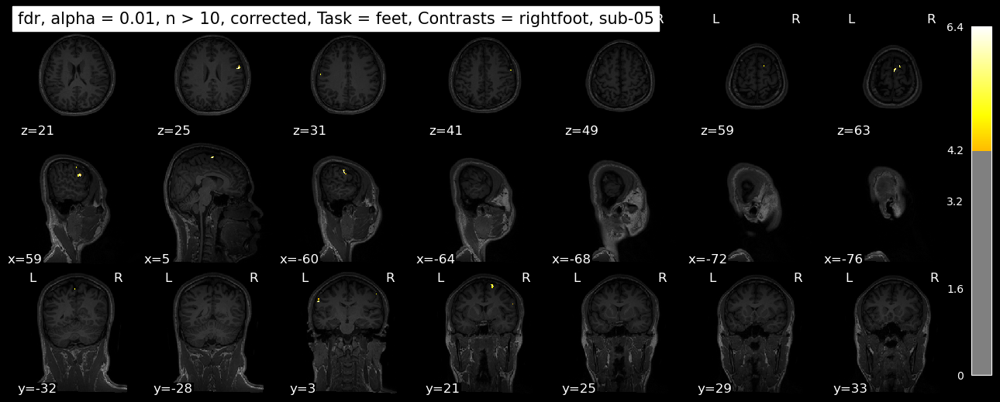

Running contrast L_min_R


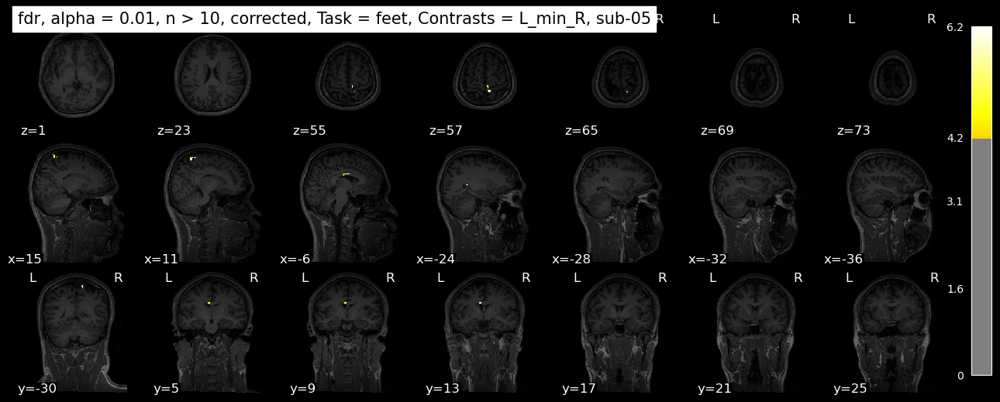

Running contrast R_min_L


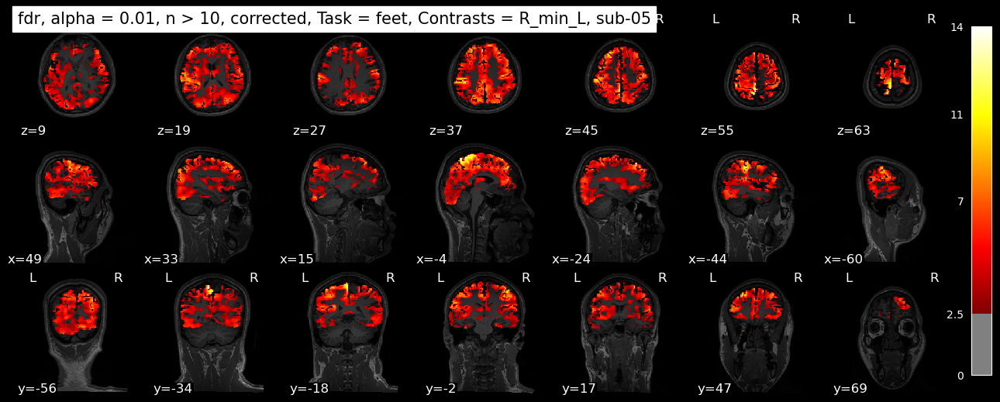

Analyzing the fing task.
Running contrast finger


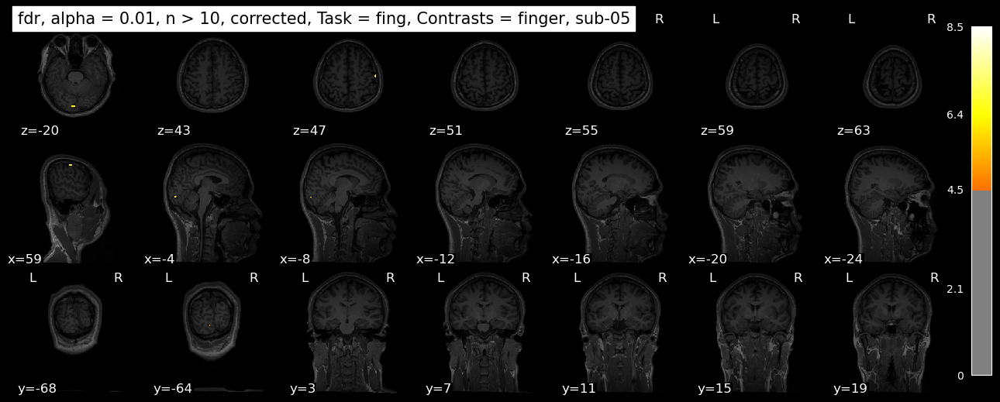

Analyzing the vis task.
Running contrast face


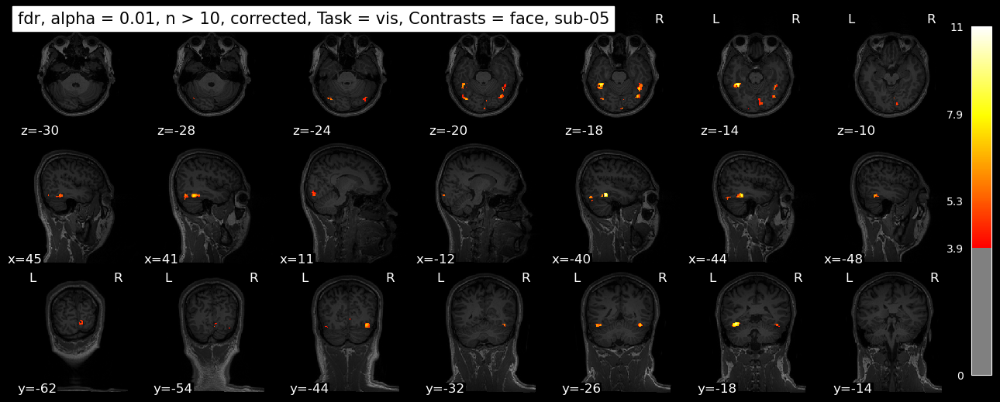

Running contrast scramble


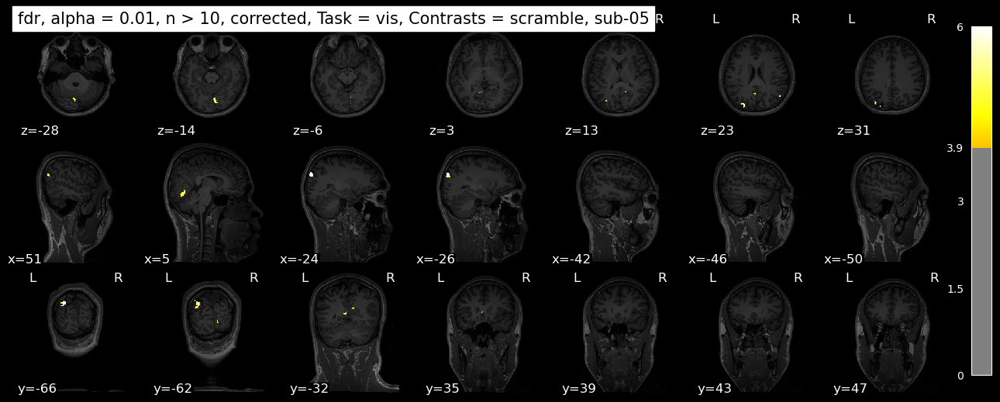

Running contrast face_min_scramble


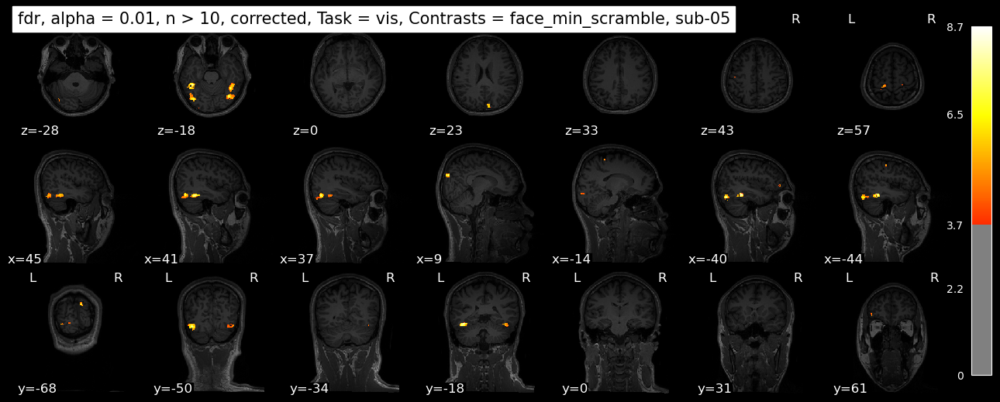

Running contrast house


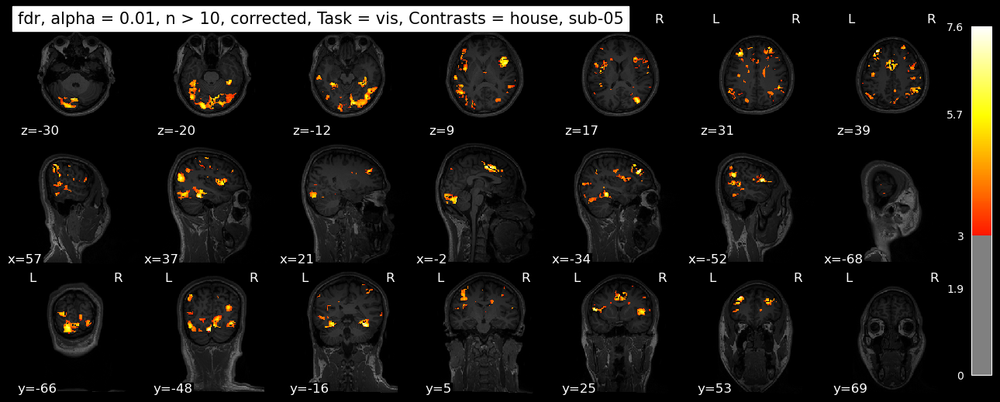

Analyzing sub-06.
23.08 % completed
Estimated remaining time: 0.0 hours, 33.0 minutes.


FileNotFoundError: No such file or no access: 'I:/9008_CBT_HNP/MEG-EEG-fMRI/dataset_bids/bids/sub-06/anat/sub-06_T1w.nii.gz'

In [8]:
# Start the time count to track the remaining computation time
start_time = time.time()

# Total number of subjects for progress tracking
tot_perf = len(subjects)  

# Loop through subjects
for count_perf, sub in enumerate(subjects):
    try:
        print(f"Analyzing {sub}.")
        logger.info(f"Analyzing {sub}.")

        # Track progress
        trackprogress(count_perf, tot_perf, start_time, logger)

        sub_derivatives_dir = Path(local_dir) / 'derivatives' / sub
        
        # Load the T1 image if plotting
        if plotting == True:
            anat_path = Path(local_dir) / 'bids' / sub / 'anat' 
            T1_path = anat_path / f"{sub}_T1w.nii.gz"
            T1_img = nib.load(T1_path)
            logger.info(f"Loaded T1 image for {sub}.")

        # Def derivatives anat outdir
        brainmask_outdir = sub_derivatives_dir / 'anat'
        brainmask_outdir.mkdir(parents=True, exist_ok=True)

        # From the ribbon mask, create a brain_mask that will be used to mask the fMRI data
        brain_mask = process_ribbon(sub, local_dir, brainmask_outdir)
        if plotting == True:
            # Plot the brain mask
            plot_stat_map(brain_mask, T1_img, title=f'Brain mask {sub}')
            plt.show()
            plt.close()

        # Loop through tasks
        for task, contrasts in tasks_contrasts.items():
            try:
                logger.info(f"Analyzing the {task} task.")
                print(f"Analyzing the {task} task.")

                # Initialize correction parameters for the current task
                correc_param = CorrectionParam(task)
                alpha = correc_param.fMRI_ALPHA
                corr_method = correc_param.fMRI_CORRECTION_METHOD
                clustersize = correc_param.fMRI_CLUSTER_THRES
                twosided = correc_param.fMRI_TWOSIDED
                
                # Define the output directory for contrasts 
                contrast_outdir = sub_derivatives_dir / 'func' / f'task-{task}'
                contrast_outdir.mkdir(parents=True, exist_ok=True)

                # Loop through contrasts
                for index, contrast in enumerate(contrasts):
                    logger.info(f"Running contrast {contrast}")
                    print(f"Running contrast {contrast}")
                    
                    try:
                        # File path for the z-score map
                        zscore_path = contrast_outdir / f"{sub}_task-{task}_contrast-{contrast}_desc-stat-z_statmap.nii.gz"
                        
                        # If the z-score map does not exist, compute and save it, else load it
                        if not zscore_path.exists():
                            # Load the tcontrast
                            t_contrast_path = sub_derivatives_dir / 'func' / f'task-{task}' / f"{sub}_task-{task}_contrast-{contrast}_desc-stat-t_statmap.nii.gz"
                            t_contrast = nib.load(t_contrast_path)
                            
                            # Get the degree of freedom from the NIfTI header
                            dof = extract_dof_from_niftiheader(t_contrast.header)

                            # Transform to zscore
                            z_nifti = process_t2zscore(t_contrast, dof, index + 1, contrast, zscore_path)

                            # Free space
                            del t_contrast

                        else:
                            z_nifti = nib.load(zscore_path)
                            dof = extract_dof_from_niftiheader(z_nifti.header)

                        # Resample the brain mask to fit to the fMRI data 
                        resample_brain_mask_path = brainmask_outdir / f"{sub}_brainmask_desc-resamp2fmri.nii.gz"
                        if not resample_brain_mask_path.exists():
                            resample_brain_mask = resample_and_threshold_image(brain_mask, z_nifti.affine, z_nifti.shape, resample_brain_mask_path)
                        else:
                            resample_brain_mask = nib.load(resample_brain_mask_path)

                        # Mask the zscore
                        brain_mask_nifti_masker = NiftiMasker(resample_brain_mask)
                        masked_zscore = brain_mask_nifti_masker.inverse_transform(brain_mask_nifti_masker.fit_transform(z_nifti))

                        # Save it
                        masked_zscore_path = Path(f"{zscore_path.with_suffix('').with_suffix('')}_masked.nii.gz")
                        nib.save(masked_zscore, masked_zscore_path)
                        logger.info(f"Masked z-score saved at {masked_zscore_path}")

                        # Proceed to thresholding the z-score map
                        threshold_zscore, thres = threshold_stats_img(masked_zscore, alpha=alpha, height_control=corr_method,
                                                                      cluster_threshold=clustersize, two_sided=twosided)
                        if plotting == True:
                            plot_stat_map(threshold_zscore, T1_img, threshold=thres, display_mode="mosaic", cmap=plt.cm.hot,
                                          title=f"{corr_method}, alpha = {alpha}, n > {clustersize}, corrected, Task = {task}, Contrasts = {contrast}, {sub}")
                            plt.show()
                            plt.close()
                            
                        # Define the output directory and file path for the thresholded z-score map
                        thres_outdir = contrast_outdir / f'corr-{corr_method}'
                        thres_outdir.mkdir(parents=True, exist_ok=True)

                        # Define the path for the thresholded z-score map
                        thresholded_path = thres_outdir / f"{masked_zscore_path.with_suffix('').with_suffix('').name}_corr-{corr_method}_alpha-{alpha}_cluster-{clustersize}_twosided-{twosided}.nii.gz"

                        # Add information in the NIfTI header description
                        description = f"{{Z_[{dof}]}} - contrast {index + 1}: {contrast}, threshold = {round(thres, 3)}, alpha = {alpha}, n >  {clustersize}, {corr_method}".encode('utf-8')[:80]
                        new_descrip = np.array(description, dtype='|S80')
                        threshold_zscore.header['descrip'] = new_descrip

                        # Save the thresholded z-score map
                        nib.save(threshold_zscore, thresholded_path)
                        logger.info(f"Thresholded z-score saved at {thresholded_path}")
                        
                    except Exception as e:
                        logger.error(f"Error processing contrast {contrast}: {str(e)}")
                        # Remove all handlers associated with the root logger
                        raise e
            except Exception as e:
                logger.error(f"Error processing task {task}: {str(e)}")
                raise e
    except Exception as e:
        logger.error(f"Error processing subject {sub}: {str(e)}")
        raise e
    
logger.info("Processing completed.")

## Comparison of Thresholded Z-Scores (Corrected and Uncorrected)

In the following section, you can select a subject, task, and contrast to visualize the z-scores. The steps include:

1. **Plot Unmasked and Uncorrected Z-Scores**:
   - Display the z-scores without any masking or correction.
   - Apply a threshold based on the chosen p-value.

2. **Plot Previously Thresholded Z-Scores**:
   - Display the thresholded contrasts obtained from the previous steps.

This comparison allows for a visual assessment of the differences between uncorrected and corrected z-scores, as well as the impact of masking and thresholding on the results.

*Select the subject, task, and contrast you want to plot by adjusting the variables `sub`, `task`, and `contrast`.*

In [ ]:
# Select the subject, task, and contrast for visualization
sub = subjects[0]

# Def the subject derivatives dir
sub_derivatives_dir = Path(local_dir) / 'derivatives_2' / sub
task = list(tasks_contrasts.keys())[3]

# Initialize correction parameters for the current task
correc_param = CorrectionParam(task)
alpha = correc_param.fMRI_ALPHA
corr_method = correc_param.fMRI_CORRECTION_METHOD
clustersize = correc_param.fMRI_CLUSTER_THRES
twosided = correc_param.fMRI_TWOSIDED

# Select the contrast to visualize
contrast = tasks_contrasts[task][0]

print(f"Running contrast '{contrast}' for task '{task}'.")

*Load the anatomical data.*

In [ ]:
# Define the output directory for the anatomical image
anat_outdir = sub_derivatives_dir / 'anat'

# Ensure the output directory exists
anat_outdir.mkdir(parents=True, exist_ok=True)

# Define the path to the resampled anatomical image
anat_path = anat_outdir / f"{sub}_space-native_desc-T1_mprage_sag_p2_iso_Fov256.nii.gz"

# Load the resampled anatomical image
if anat_path.exists():
    T1_img = nib.load(anat_path)
else:
    raise FileNotFoundError(f"Anatomical image not found: {anat_path}")

In [ ]:
# Define the output directory for contrasts
contrast_dir = sub_derivatives_dir / 'func' / f'task-{task}'

# Construct the path to the z-score statistical map
zscore_path = contrast_dir / (
    f"{sub}_task-{task}_space-native_desc-contrast-{contrast}_stat-z_statmap.nii.gz"
)

# Check if the z-score image file exists
if not zscore_path.exists():
    raise FileNotFoundError(f"File not found: {zscore_path}")

# Load the z-score NIfTI image
zscore = nib.load(zscore_path)

# Plot the statistical map
plot_stat_map(
    zscore, T1_img, threshold=norm.isf(pvalue), display_mode="mosaic",
    title=f"alpha = {pvalue}, Task = {task}, Contrasts = {contrast}, {sub}"
)

# Define the output directory for contrasts
thres_dir = contrast_dir / f'corr-{corr_method}'

# Construct the path to the thresholded image
thresholded_path = thres_dir / (
    f"{sub}_task-{task}_space-native_desc-contrast-{contrast}_stat-z_statmap_masked_"
    f"correction-{corr_method}_alpha-{alpha}_cluster-{clustersize}_twosided-{twosided}.nii.gz"
)

# Check if the thresholded image file exists
if not thresholded_path.exists():
    raise FileNotFoundError(f"File not found: {thresholded_path}")

# Load the thresholded NIfTI image
zscore_thres = nib.load(thresholded_path)

# Extract the threshold value from the NIfTI header description
thres = extract_threshold(zscore_thres)

# Plot the statistical map
plot_stat_map(
    zscore_thres, T1_img, threshold=thres, display_mode="mosaic", cmap = plt.cm.hot,
    title=f"{corr_method}, alpha = {alpha}, n > {clustersize}, corrected, Task = {task}, Contrasts = {contrast}, {sub}"
)